### Load and Modify Configuration File

In [1]:
from configs.config_loader import load_config
config = load_config('configs/default.yaml')

version : default
seed : 1
y0 : 0.001
T : 10
N_col : 1024
N_hidden : 4
N_neurons : 50
activation : swish
N_epochs : 50000
learning_rate : 0.001
decay_rate : 1.0
freq_log : 100
freq_print : 1000
keys_print : ['loss']
freq_save : 100
regularization : reg_derivative_unstable_fp
reg_coeff : 100000
reg_decay : 1
reg_epochs : 1


### Initialize Physics-Informed Neural Network

In [2]:
from model.neural_net import PhysicsInformedNN
PINN = PhysicsInformedNN(config, verbose=True)

2024-10-12 18:46:57.868622: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-10-12 18:46:57.908888: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-10-12 18:46:57.909516: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-12 18:46:58.569824: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Model: "nested_PINN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 50)                100       
                                                                 
 dense_1 (Dense)             (None, 50)                2550      
                                                                 
 dense_2 (Dense)             (None, 50)                2550      
                                                                 
 dense_3 (Dense)             (None, 50)                2550      
                                                                 
 dense_4 (Dense)             (None, 1)                 51        
                                                                 
Total params: 7801 (30.47 KB)
Trainable params: 7801 (30.47 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
*** PINN build & init

### Train Physics-Informed Neural Network

In [3]:
training_log = PINN.train()

Training started...
    0/50000 | loss: 1.63e-02
 1000/50000 | loss: 8.50e-03
 2000/50000 | loss: 1.06e-02
 3000/50000 | loss: 2.13e-02
 4000/50000 | loss: 2.23e-03
 5000/50000 | loss: 5.59e-04
 6000/50000 | loss: 6.10e-03
 7000/50000 | loss: 4.88e-04
 8000/50000 | loss: 3.67e-03
 9000/50000 | loss: 3.94e-04
10000/50000 | loss: 1.14e-03
11000/50000 | loss: 1.32e-03
12000/50000 | loss: 1.98e-04
13000/50000 | loss: 5.00e-04
14000/50000 | loss: 1.09e-05
15000/50000 | loss: 1.43e-03
16000/50000 | loss: 1.83e-03
17000/50000 | loss: 8.86e-06
18000/50000 | loss: 1.25e-03
19000/50000 | loss: 4.91e-04
20000/50000 | loss: 8.03e-04
21000/50000 | loss: 5.10e-04
22000/50000 | loss: 3.40e-04
23000/50000 | loss: 3.70e-04
24000/50000 | loss: 1.85e-05
25000/50000 | loss: 1.18e-03
26000/50000 | loss: 1.13e-04
27000/50000 | loss: 2.07e-05
28000/50000 | loss: 4.00e-05
29000/50000 | loss: 2.11e-04
30000/50000 | loss: 1.91e-04
31000/50000 | loss: 6.63e-05


# Plot Section

In [ ]:
from model.plots import learning_curves, toy_example_dynamics, loss_over_tcoll, plot_regularization

### Learning Curves

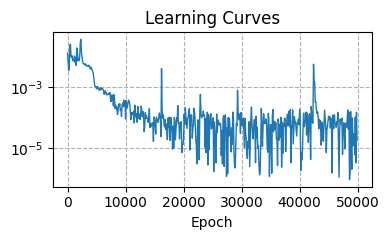

In [ ]:
learning_curves(training_log)

### Toy Example Dynamics

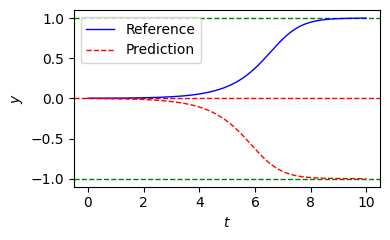

In [ ]:
toy_example_dynamics(PINN)

(1000, 1)
(1000, 1)


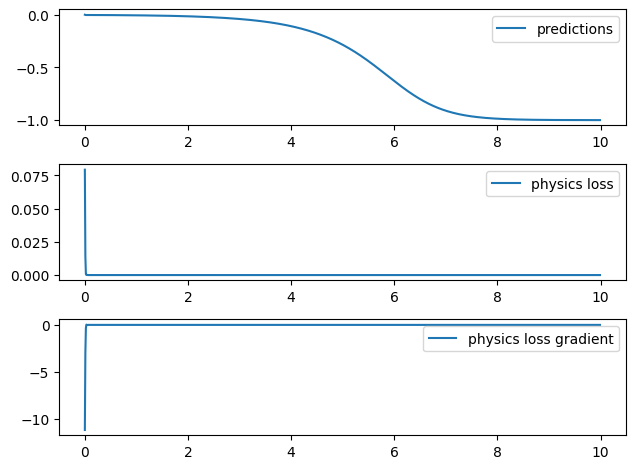

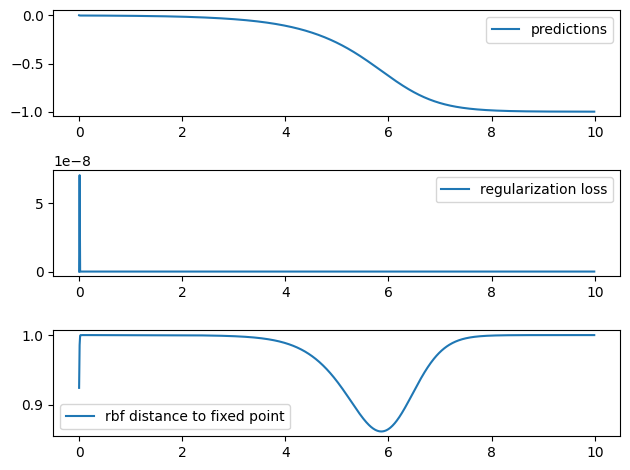

In [ ]:
import tensorflow as tf

t_col = PINN.data.t_line()
pred = PINN(t_col)

print(t_col.shape)
print(pred.shape)

loss_over_tcoll(PINN)

plot_regularization(PINN)


### Training animation

In [ ]:
import matplotlib.pyplot as plt
import os
from matplotlib.animation import FuncAnimation, FFMpegWriter
from IPython.display import HTML



def init_fig():

    fig, ax = plt.subplots()

    #############################
    ### Initial plot comes here
    #############################

    plt.tight_layout()
    plt.close(fig)
    return fig, ax


def animate(i, *fargs):
    # get passed arguments
    ax = fargs[0]
    N_times = fargs[1]

    # print status of animation
    print(f'Processed: {i/N_times*100:.0f}%', end='\r')

    # clear axis
    ax.clear()

    #############################
    ### load model weights & make predictions
    #############################
    flag = i * config['freq_save']
    PINN.load_weights(PINN.log_path.joinpath(f'model_weights/weights_{flag}.pkl'))
    # get (equally-spaced) data points
    t_line = PINN.data.t_line()
    # get reference solution (analytical)
    y_true = PINN.data.reference(t_line)
    # get PINN prediction
    y_pred = PINN(t_line)

    #############################
    ### Updated plot comes here
    #############################

    # include fixed point lines
    for y_fix in [-1, 1]:
        ax.axhline(y_fix, lw=1, ls='--', c='green')
    ax.axhline(0, lw=1, ls='--', c='red')

    # make plots
    ax.plot(t_line, y_true, c='blue', lw=1, label='Reference')
    ax.plot(t_line, y_pred, c='red', lw=1, ls='--', label='Prediction')

    # Axis appearance
    ax.legend()
    ax.set_ylabel(r'$y$')
    ax.set_xlabel(r'$t$')


    plt.tight_layout()


# should equal the number of saved weights files
N_frames = int(config["N_epochs"] / config["freq_save"])

(fig, ax) = init_fig()
ani = FuncAnimation(fig, animate, frames=N_frames, fargs=(ax, N_frames))
HTML(ani.to_jshtml())

<Figure size 640x480 with 0 Axes>